In [ ]:
!git clone https://github.com/nevermindOleg/embedded_ensemble_toy_model

fatal: destination path 'embedded_ensemble_toy_model' already exists and is not an empty directory.


In [ ]:
%cd embedded_ensemble_toy_model/

/content/embedded_ensemble_toy_model


In [ ]:
%load_ext tensorboard
%tensorboard --logdir ./

Reusing TensorBoard on port 6006 (pid 129), started 0:14:40 ago. (Use '!kill 129' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!pip install tensorboardX

In [ ]:
from model import *
from math import pi
import matplotlib.pyplot as plt
import numpy as np


device = "cuda"

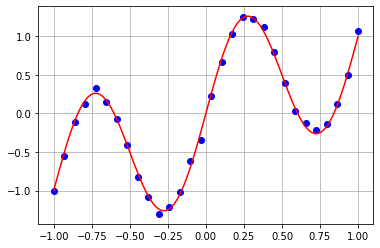

In [ ]:
# models geometry
N = 5000
M = 10
E = 10

# dataset
B = 30
target = lambda x: torch.sin(2*pi*x) + x
interval = (-1, 1)
eps = 0.05

x1,y1 = generate_data_uniform(1, 1, target, interval, B, eps)

x1 = x1.to(device)
y1 = y1.to(device)

B_test = 107
x2,y2 = generate_data_uniform(1, 1, target, interval, B_test, 0)

x2 = x2.to(device)
y2 = y2.to(device)

data_train = x1, y1
data_test = x2, y2

plt.plot(data_train[0].cpu().numpy(), data_train[1].cpu().numpy(), "bo")
plt.plot(data_test[0].cpu().numpy(), data_test[1].cpu().numpy(), "r-")
# grid = np.linspace(*interval)
# plt.plot(grid, target(torch.tensor(grid)).numpy() )
plt.grid()

In [ ]:
%%time

from torch.optim import SGD

p = torch.linspace(0,1,E).to(device)
gammas = torch.ones(E).to(device) * (M ** (1-p))

model = EnsembleSet(1, N, 1, M, E, p, device=device)
nn.init.uniform_(model.b, -1, 1)
# nn.init.ones_(model.W)

res = train_loop(
    model=model,
    n_epochs=1000,
    optimizer=SGD(model.parameters(), lr=.3),
    data_train=data_train,
    data_test=data_test,
    gammas=gammas
)

res

CPU times: user 18.6 s, sys: 3.79 s, total: 22.3 s
Wall time: 19 s


torch.Size([50, 10])


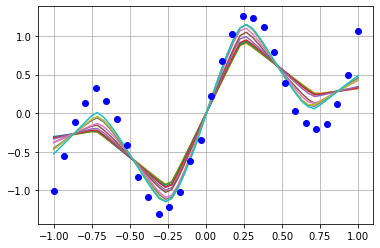

In [ ]:
grid = np.linspace(*interval)

preds = model(torch.tensor(grid, device=device, dtype=torch.float32)[:,None]).detach().cpu().squeeze()
print(preds.shape)

for e in range(E):
    plt.plot(grid, preds[:,e], "-")

plt.grid()
plt.plot(data_train[0].cpu().numpy(), data_train[1].cpu().numpy(), "bo")
# plt.scatter(data_test[0].cpu().numpy(), data_test[1].cpu().numpy())

grid = np.linspace(*interval)

# plt.plot(grid, target(torch.tensor(grid)).numpy(), "b-")

In [ ]:
def train_loop(model: EnsembleSet, n_epochs: int,
        optimizer,
        data_train: Tuple[torch.Tensor, torch.Tensor],
        data_test:  Tuple[torch.Tensor, torch.Tensor],
        gammas: Optional[torch.Tensor]=None,
        logs=None,
    ) -> Mapping[str, Any]:
    """
    Trining loop.
    :model: model to train
    :n_epochs: number of epochs
    :optimizer: instance of optimizer from torch.optim, i.e. Adam 

    :return: model after training
    """
    x_train, y_train = data_train
    x_test, y_test = data_test
    p = model.p

    if gammas is None:
        try:
            gammas = model.choose_gamma(p)
        except NotImplementedError:
            gammas = torch.ones(model.n_ensembles, device=model.device)
    
    writer = SummaryWriter()
    writer.add_scalars("p",
                {str(i):p_ for i, p_ in enumerate(p.detach().cpu())}
            )
    writer.add_scalars("gamma",
                {str(i):g for i, g in enumerate(gammas.detach().cpu())}
            )        
                
    for epoch in range(n_epochs):
        model.train()
        f_train = model(x_train)
        loss_train = model.loss(f_train, y_train)  # per-ensemble loss
        (loss_train * gammas).sum().backward(retain_graph=True)

        optimizer.step()
        optimizer.zero_grad()

        model.eval()
        with torch.no_grad():
            f_test = model(x_test)
            loss_test = model.loss(f_test, y_test)
            
            #TODO: tensorboard
            writer.add_scalars("loss/train",
                        {str(i):loss for i, loss in enumerate(loss_train.detach().cpu())}
                        , epoch)
            writer.add_scalars("loss/test",
                        {str(i):loss for i, loss in enumerate(loss_test.detach().cpu())}
                        , epoch)

            if logs is not None:
                logs[epoch, 0, :] = loss_train.detach().cpu()
                logs[epoch, 1, :] = loss_test.detach().cpu()
                # if n_epochs>0 and logs[epoch_n-1,1] < logs[epoch_n,1]:
                #     pass
    
    writer.flush()
    writer.close()
    return {"model": model}

In [ ]:
from torch._C import dtype
from itertools import product
import pandas as pd
from tqdm.notebook import tqdm


Ms = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 16, 18, 20]
Ms2 = [25, 30, 35, 40, 45, 50, 60, 70, 80, 90, 100]
Ns = [10, 30, 100, 300, 1000, 3000, 10000]
Ns = [30, 300, 3000, 10000]
Ms = [1, 5, 10,15,20]

history = [] #["p", "gamma", "N", "M", "test_loss", "train_loss"],

n_epochs = 10000
for N, M in tqdm(product(Ns, Ms), total=len(Ms)*len(Ms)):
    p = torch.linspace(0,0,E).to(device)
    gammas = torch.ones(E).to(device) * (M ** (1-p))
    model = EnsembleSet(1, N, 1, M, E, p, device=device)
    logs = torch.empty((n_epochs, 2, E), device=device)
    node = {"N":N, "M":M}
    train_loop(
        model=model,
        n_epochs=n_epochs,
        optimizer=SGD(model.parameters(), lr=.3),
        data_train=data_train,
        data_test=data_test,
        gammas=gammas,
        logs=logs
    )
    history_update = [{**node, "p":p,
                       "loss_test":test_log,
                       "loss_train":train_log} for p, test_log, train_log
                      in zip(p, logs[:,1,:].T.detach().cpu().numpy(),
                                logs[:,0,:].T.detach().cpu().numpy()
                            )
                    ]

    history += history_update



  0%|          | 0/25 [00:00<?, ?it/s]

In [40]:
df=pd.DataFrame(history)

In [41]:
df

,N,M,p,loss_test,loss_train
0,30,1,"tensor(0., device='cuda:0')","[1.5791372, 29.33747, 0.76374394, 0.655731, 0....","[0.554867, 1.6187576, 29.424093, 0.8043157, 0...."
1,30,1,"tensor(0.1111, device='cuda:0')","[0.578909, 0.5421845, 0.5041099, 0.48385942, 0...","[0.6850319, 0.6004225, 0.5520832, 0.5258076, 0..."
2,30,1,"tensor(0.2222, device='cuda:0')","[0.64903414, 0.5408683, 0.45695478, 0.4399623,...","[0.9673956, 0.65579975, 0.5612385, 0.46979314,..."
3,30,1,"tensor(0.3333, device='cuda:0')","[20.270576, 0.7976527, 0.6023999, 0.53510606, ...","[3.331227, 20.564785, 0.8052727, 0.6108056, 0...."
4,30,1,"tensor(0.4444, device='cuda:0')","[0.5031314, 0.49107313, 0.48192918, 0.4737265,...","[0.56918275, 0.520277, 0.5084895, 0.4993738, 0..."
5,30,1,"tensor(0.5556, device='cuda:0')","[0.7396062, 0.66577744, 0.5895717, 0.5391195, ...","[0.83938307, 0.7829218, 0.68363905, 0.619877, ..."
6,30,1,"tensor(0.6667, device='cuda:0')","[0.45843965, 0.44786847, 0.43921202, 0.4321898...","[0.58186346, 0.47518513, 0.4650962, 0.45638403..."
7,30,1,"tensor(0.7778, device='cuda:0')","[0.5289568, 0.49555612, 0.48513165, 0.4792817,...","[0.72199506, 0.55153346, 0.51476717, 0.5026956..."
8,30,1,"tensor(0.8889, device='cuda:0')","[0.49913153, 0.48995754, 0.4856045, 0.48094746...","[0.8771146, 0.505319, 0.49584097, 0.4913843, 0..."
9,30,1,"tensor(1., device='cuda:0')","[0.60704064, 0.58153456, 0.5669858, 0.55374384...","[0.8059994, 0.6296812, 0.60151327, 0.58594424,..."


In [42]:
df.to_pickle("file.pkl")